# NVIDIA + Labelbox

### Learn how to train and deploy a bounding box model using Labelbox, TLT, TRT, and Triton Inference Server

* Based on https://ngc.nvidia.com/catalog/resources/nvidia:tlt_cv_samples/version/v1.0.2/files/detectnet_v2/detectnet_v2.ipynb

##### Turn any labelbox bounding box project into a deployed service by following this notebook

#### Contents:
    1. Configure environment
        * Setup environment
        * Install dependencies
    2. ETL
        * Export data from labelbox and convert into tfrecords
    3. Train
        * Create a trained model
    4. Prune and Retrain
    5. Evaluate
        * Compute metrics
        * Visualize
    6. Deploy
        * Deploy tensorrt server
        * Client code to test server
    

##### Requirements:

* python >=3.6.9 < 3.8.x
* docker-ce > 19.03.5
* docker-API 1.40
* nvidia-container-toolkit > 1.3.0-1
* nvidia-container-runtime > 3.4.0-1
* nvidia-docker2 > 2.5.0-1
* nvidia-driver > 455+
* \>= 1 nvidia gpu

## Configure environment

In [ ]:
import os
import json
import shutil

#### Set these for your data

* <b>This is the only cell that <i>needs</i> to be updated</b>
* Everything else in the notebook is dynamically configured based on these params

In [ ]:
#Which classes to grab from a project.
#The model will ignore classes not listed here.
class_mappings = {
    'animal' : 'animal',
    'person' : 'person'
}

#grab this from the url of your project.
#You can also search using the sdk
LABELBOX_PROJECT_ID = "ckq778m4g0edr0yao004l41l7"
#If you are using your own bbox project, set this to true
USE_RANDOM_PARTITIONING = False 
#Format of your labelbox data
IMAGE_FORMAT = ".jpg" 
#TLT Does not support dynamic resizing.
#Image must be resized prior to training (and labels must be scaled accordingly)
#This code in this notebook will handle this, but the desired size must be set here.
IMAGE_W = 1024 // 2
IMAGE_H = 768 // 2
#Number of epochs for training
TRAINING_EPOCHS = 140
#Number of epochs for training the pruned model
RETRAIN_EPOCHS = 80
#Number of gpus available
%env NUM_GPUS=1

In [ ]:
MODEL_NAME = os.environ['MODEL_NAME'] = "resnet"
NUM_LAYERS = os.environ['NUM_LAYERS'] = str(18)

In [ ]:
#Root of your project:
#This should be where you are running your notebook from.
LOCAL_ROOT = os.environ["LOCAL_ROOT"] = os.getcwd()

In [ ]:
### Login to ngc

docker_config_path = os.path.join(os.path.expanduser("~"), '.docker', 'config.json')
docker_config = json.load(open(docker_config_path))

if "nvcr.io" not in docker_config['auths']:    
    if os.environ.get('NGC_TOKEN') is None:
        print("Please set $NGC_TOKEN")
        print("If you do not have a token you can sign up for one here: https://ngc.nvidia.com/signin")
    else:
        #Note that #oauthtoken isn't something that should be set.
        !echo $NGC_TOKEN | docker login --username "\$oauthtoken"  --password-stdin nvcr.io    

In [ ]:
#None of this needs to be modified.

%env KEY=tlt_encode
colors = [[255,0,0], [0,255,0], [0,0,255], [255,255,0], [0,255,255]]
DOCKER_ROOT = os.environ["DOCKER_ROOT"] = "/workspace/tlt-experiments"
EXPERIMENT_DIR = os.environ["EXPERIMENT_DIR"] = "detectnet_v2"
DATA_DIR = os.environ["DATA_DIR"] = "data"
SPECS_DIR = os.environ["SPECS_DIR"] = "resources"
IMAGE_DIR = os.environ["IMAGE_DIR"] = "image_2"
LABEL_DIR = os.environ["LABEL_DIR"] = "label_2"
TRAINING_DIR = os.environ["TRAINING_DIR"] = os.path.join(DATA_DIR, "training")
TESTING_DIR = os.environ["TESTING_DIR"] = os.path.join(DATA_DIR, "testing")

TRAIN_IMAGE_DIR = os.environ['TRAIN_IMAGE_DIR'] = os.path.join(LOCAL_ROOT, TRAINING_DIR,IMAGE_DIR )
TRAIN_LABEL_DIR = os.environ['TRAIN_LABEL_DIR'] = os.path.join(LOCAL_ROOT,TRAINING_DIR, LABEL_DIR)
TEST_IMAGE_DIR = os.environ['TEST_IMAGE_DIR'] = os.path.join(LOCAL_ROOT, TESTING_DIR, IMAGE_DIR)
TEST_LABEL_DIR = os.environ['TEST_LABEL_DIR'] = os.path.join(LOCAL_ROOT,TESTING_DIR, LABEL_DIR)

TF_RECORD_PROTO = os.environ['TF_RECORD_PROTO'] = f"detectnet_v2_tfrecords_kitti_trainval.txt"
BASIC_TRAIN_PROTO = os.environ['BASIC_TRAIN_PROTO'] = f"detectnet_v2_train_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"
TRAIN_RANDOM_INIT_PROTO = os.environ['TRAIN_RANDOM_INIT_PROTO'] = f"detectnet_v2_not_pretrained_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"
TLT_INFERENCE_PROTO = os.environ['TLT_INFERENCE_PROTO'] = f"detectnet_v2_inference_{MODEL_NAME}{NUM_LAYERS}_kitti_tlt.txt"
TRT_INFERENCE_PROTO = os.environ['TRT_INFERENCE_PROTO'] = f"detectnet_v2_inference_{MODEL_NAME}{NUM_LAYERS}_kitti_trt.txt"
RETRAIN_PROTO = os.environ['RETRAIN_PROTO'] = f"detectnet_v2_retrain_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"

os.environ['IMAGE_H'] = str(IMAGE_H)
os.environ['IMAGE_W'] = str(IMAGE_W)

!mkdir -p $TRAIN_IMAGE_DIR
!mkdir -p $TRAIN_LABEL_DIR
!mkdir -p $TEST_IMAGE_DIR
!mkdir -p $TEST_LABEL_DIR
!mkdir -p $EXPERIMENT_DIR

In [ ]:
#TLT works by running all commands in docker containers.
# Here we map local directories to the TLT docker.
mounts_file = os.path.expanduser("~/.tlt_mounts.json")
# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_ROOT"],
            "destination": os.environ["DOCKER_ROOT"]
        },
        # Mapping the specs directory.
        {
            "source": os.path.join(os.environ["LOCAL_ROOT"], os.environ["SPECS_DIR"] ),
            "destination": os.path.join(os.environ["DOCKER_ROOT"], os.environ["SPECS_DIR"] )
        },
    ]
}

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)

In [ ]:
!cat ~/.tlt_mounts.json

### Install dependencies 

In [ ]:
# Installing NGC CLI on the local machine.
## Download and install

!pip install nvidia-pyindex
!pip install nvidia-tlt --upgrade
!pip install labelbox
!pip install nvidia-pyindex
!pip install nvidia-tlt
!pip install matplotlib==3.3.3
!pip install PILLOW
!pip install requests
!pip install tqdm
!pip install numpy


In [ ]:
if shutil.which("ngc") is None:
    %env CLI=ngccli_reg_linux.zip
    !mkdir -p $LOCAL_ROOT/ngccli
    # Remove any previously existing CLI installations
    !rm -rf $LOCAL_ROOT/ngccli/*
    !wget "https://ngc.nvidia.com/downloads/$CLI" -P $LOCAL_ROOT/ngccli
    !unzip -u "$LOCAL_ROOT/ngccli/$CLI" -d $LOCAL_ROOT/ngccli/
    !rm $LOCAL_ROOT/ngccli/*.zip 
    os.environ["PATH"]="{}/ngccli:{}".format(os.getenv("LOCAL_ROOT", ""), os.getenv("PATH", ""))

In [ ]:
import requests
from multiprocessing.pool import ThreadPool as Pool
from tqdm import tqdm
from io import BytesIO
import random
import os
import time
import cv2
import numpy as np
from PIL import Image
from math import ceil
import matplotlib.pyplot as plt
from collections import defaultdict

import labelbox as lb

from google.protobuf import text_format
from google.protobuf.text_format import Merge, MessageToString
from google.protobuf.json_format import ParseDict

from tritonclient import http as tritonhttpclient
from tritonclient.grpc import model_config_pb2 as mc
from tritonclient.utils import triton_to_np_dtype
from tritonclient.utils import InferenceServerException


In [ ]:
import sys
sys.path.insert(0, 'resources/proto')
from proto import (
    dataset_export_config_pb2,
    experiment_pb2, 
    inference_pb2
)

In [ ]:
#Helper functions for later
def load_proto(filename, proto):
    return Merge(str(open(filename).read()), proto)

def load_reference_proto(filename, proto):
    parts = filename.split("/")
    path = os.path.join(*parts[:-1])
    filename = os.path.join(path, "reference_specs", parts[-1])
    return load_proto(f"/{filename}", proto) 



## ETL


### Data overview

- Data is set based on the LABELBOX_PROJECT_ID configured above.
- The data used for testing this notebook in the demo here is from https://beerys.github.io/CaltechCameraTraps/
    * We sampled a small subset and mapped all of the classes to animal.
    * Then we went through the subset and labeled the humans using labelbox
    * See the mal notebook (`labelbox_upload.ipynb`) for setting up the labeling task
------
The ETL process has the following steps:
1. Export labels from labelbox
2. Convert the data into the kitti format
3. Serialize to tfrecords

In [ ]:
client = lb.Client()

In [ ]:
project = client.get_project(LABELBOX_PROJECT_ID)
labels = project.export_labels()
data = requests.get(labels).json()

In [ ]:
def bbox_to_kitti(label, scale_w, scale_h):
    """
    - Reformat labelbox bounding box labels to kitti
    - Scales bbox coordinates to match the resizing applied to the image.
    """
    
    class_name = label['name']
    bbox = label['bbox']
    return ' '.join([str(x) for x in 
            [class_name,                               # object name
            0.0,                                       # truncated  - unused
            0,                                         # occluded   -  unused
            0.0,                                       # alpha      -  unused
            bbox['left'] * scale_w,                    # left      
            bbox['top'] * scale_h,                     # top
            (bbox['left'] + bbox['width']) * scale_w,  # right
            (bbox['top'] + bbox['height']) * scale_h,  # bottom            
            0.0,                                       # dims       -  unused
            0.0,                                       # dims       -  unused
            0.0,                                       # dims       -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # rotation_y -  unused
        ]])
              

def filter_labels(row):
    """
    Reads a sinlge label from a labelbox export and extracts only bounding box annotations
    """
    labels = [
        {
            'bbox' : obj.get('bbox'),
            'name' : obj.get('title')
        } 
        for obj in row['Label'].get('objects',[]) if (
            obj.get('bbox') is not None and obj.get('title') in class_mappings
        )
    ]
    return labels
    

In [ ]:
%matplotlib


def get_unique_locations(row, labels_path):
    if not hasattr(get_unique_locations, 'unique_locations'):        
        unique_locations = {json.load(open(os.path.join(labels_path,f)))['location'] for f in os.listdir(labels_path)}
        get_unique_locations.unique_locations = list(unique_locations)
    return get_unique_locations.unique_locations

    
def partition_sequential_data(row):
    """
    - The animal data comes from video frames 
        we don't want the train and test data to come from the same camera locations.
    """
    labels_path = os.path.join(os.environ.get('LOCAL_ROOT'), 'labels')
    location_file = row['External ID'].split('/')[-1].replace('.jpg', '.json')    
    location = json.load(open(os.path.join(labels_path, location_file)))['location']
    unique_locations = get_unique_locations(row, labels_path)
    random.seed(1)
    random.shuffle(unique_locations)
    train_locations = unique_locations[:int(len(unique_locations)*0.7)]
    test_locations = unique_locations[int(len(unique_locations)*0.7):]
    if location in train_locations:
        return "train"
    elif location in test_locations:
        return "test"
    else:
        raise ValueError(f"location `{location}` not found in test or train locations")
        
def partition_function(row, test_percentage = 0.15):
    """
    If not using sequential data then the random partitioning is fine.
    """
    if USE_RANDOM_PARTITIONING:
        if random.random() < test_percentage:
            return 'test'
        else:
            return 'train'
    return partition_sequential_data(row)
        
def labels_to_kitti(labels, scale_w, scale_h):
    kitti = []
    for label in labels:
        kitti.append(bbox_to_kitti(label, scale_w, scale_h))
    return '\n'.join(kitti)

def serialize_example(image, labels, file_name, image_dir, label_dir):
    image = image.convert('RGB')
    image.save(os.path.join(image_dir, f"{file_name}.jpg"))
    with open(os.path.join(label_dir, f"{file_name}.txt"), 'w') as file:
        file.write(labels)
    
def run_row(row):
    idx, row = row
    labels = filter_labels(row)
    if not len(labels):
        return
    
    image = row['Labeled Data']
    image_data = Image.open(BytesIO(requests.get(image).content))
    orig_w, orig_h = image_data.size
    image_data = image_data.resize((IMAGE_W, IMAGE_H))
    file_name = str(idx).zfill(5)
    image = requests.get(data[1]['Labeled Data'])    
    labels = labels_to_kitti(labels, IMAGE_W / orig_w, IMAGE_H /orig_h  )
    dataset = partition_function(row)

    if dataset == 'train':
        serialize_example(image_data, labels, file_name, TRAIN_IMAGE_DIR, TRAIN_LABEL_DIR)
    elif dataset == 'test':
        serialize_example(image_data, labels, file_name, TEST_IMAGE_DIR, TEST_LABEL_DIR)
    else:
        raise ValueError(f"Partition function returned `{dataset}`. Expected `train` or `test")
        

        
with Pool(12) as pool:
    list(tqdm(pool.imap(run_row, [[idx,r] for idx, r in enumerate(data)]), total = len(data)))


In [ ]:
# verify
num_training_images = len(os.listdir(TRAIN_IMAGE_DIR))
num_training_labels = len(os.listdir(TRAIN_LABEL_DIR))
num_testing_images = len(os.listdir(TEST_IMAGE_DIR))
num_testing_labels = len(os.listdir(TEST_LABEL_DIR))
print("Number of images in the train/val set. {}".format(num_training_images))
print("Number of labels in the train/val set. {}".format(num_training_labels))
print("Number of images in the test set. {}".format(num_testing_images))
print("Number of labels in the test set. {}".format(num_testing_labels))

In [ ]:
# Sample kitti label.
!cat $TRAIN_LABEL_DIR/00001.txt

### Convert Kitti data to tfrecords

In [ ]:
# Configure tf records
tf_record_proto = load_reference_proto(os.path.join(LOCAL_ROOT, SPECS_DIR, TF_RECORD_PROTO), dataset_export_config_pb2.DatasetExportConfig())
tf_record_proto.kitti_config.image_dir_name = os.environ['IMAGE_DIR']
tf_record_proto.kitti_config.label_dir_name = os.environ['LABEL_DIR']
tf_record_proto.kitti_config.image_extension = IMAGE_FORMAT
tf_record_proto.kitti_config.root_directory_path = os.path.join(DOCKER_ROOT, TRAINING_DIR)
tf_record_proto.image_directory_path = os.path.join(DOCKER_ROOT, TRAINING_DIR)
tf_record_proto.kitti_config.num_partitions = 2
tf_record_proto.kitti_config.num_shards = 2

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TF_RECORD_PROTO), 'w') as file:
    file.write(str(tf_record_proto))

In [ ]:
print("TFrecords conversion spec file for kitti training")
!cat $LOCAL_ROOT/$SPECS_DIR/$TF_RECORD_PROTO

In [ ]:
print("Converting Tfrecords for kitti trainval dataset")
!/usr/local/bin/tlt detectnet_v2 dataset_convert \
                  -d $DOCKER_ROOT/$SPECS_DIR/$TF_RECORD_PROTO \
                  -o $DOCKER_ROOT/$DATA_DIR/tfrecords/kitti_trainval/


In [ ]:
!ls -rlt $LOCAL_ROOT/$DATA_DIR/tfrecords/kitti_trainval/

## Training

####  Download pre-trained model 

In [ ]:
# There are a lot of different models available from ngc. In this demo we only use resnet18
# The following command lists models available in the model registry.
#!ngc registry model list nvidia/tlt_pretrained_detectnet_v2:*

In [ ]:
# Create the target destination to download the model.
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS/

In [ ]:
# Download the pretrained model from NGC

!ngc registry model download-version \
    nvidia/tlt_pretrained_detectnet_v2:$MODEL_NAME$NUM_LAYERS \
    --dest $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS


In [ ]:
#Check that the file exists
PRETRAINED_WEIGHTS_DIR = os.listdir(os.path.join(EXPERIMENT_DIR,f"pretrained_{MODEL_NAME}{NUM_LAYERS}"))
assert len(PRETRAINED_WEIGHTS_DIR), "Pretrained model weights did not download properly"
PRETRAINED_WEIGHTS = os.listdir(os.path.join(EXPERIMENT_DIR,f"pretrained_{MODEL_NAME}{NUM_LAYERS}", PRETRAINED_WEIGHTS_DIR[0]))
assert len(PRETRAINED_WEIGHTS), "Pretrained model weights did not download properly"
PRETRAINED_WEIGHTS = os.path.join(PRETRAINED_WEIGHTS_DIR[0], PRETRAINED_WEIGHTS[0])
PRETRAINED_WEIGHTS = os.environ["PRETRAINED_WEIGHTS"] = PRETRAINED_WEIGHTS

#Make sure file exists..
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS/$PRETRAINED_WEIGHTS

#### Configure Training Params

In [ ]:
#Overwrite protos with information set at the top of the notebook and sensible defaults.

tf_train_proto = load_reference_proto(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())

default_postprocessing_params = {
  "coverage_threshold": 0.00499999988824,
  "minimum_bounding_box_height": 10,
  "dbscan_eps": 0.20000000298,
  "dbscan_min_samples": 0.0500000007451,
  "dbscan_confidence_threshold": 0.9
}

default_eval_config = {
    'default_eval_box' :{
      "minimum_height" : 10,
      "maximum_height" : 9999,
      "minimum_width" : 10,
      "maximum_width" : 9999
    },
    'default_eval_overlap' : 0.5
}

default_cost_function_config = {
    "class_weight" : 1.0,
    "coverage_foreground_weight" : 0.0500000007451,
}

default_rasterizer_config = {
      "cov_center_x": 0.5,
      "cov_center_y": 0.5,
      "cov_radius_x": 0.40000000596,
      "cov_radius_y": 0.40000000596,
      "bbox_min_radius": 1.0
}

#Set paths
tf_train_proto.dataset_config.data_sources[0].tfrecords_path = os.path.join(DOCKER_ROOT, DATA_DIR, "tfrecords/kitti_trainval", "*")
tf_train_proto.dataset_config.data_sources[0].image_directory_path = os.path.join(DOCKER_ROOT,TRAINING_DIR)
tf_train_proto.dataset_config.image_extension = IMAGE_FORMAT.replace('.', '')
#Set classes
tf_train_proto.dataset_config.target_class_mapping.clear()
tf_train_proto.dataset_config.target_class_mapping.update(class_mappings)
#Set image information
tf_train_proto.augmentation_config.preprocessing.output_image_width = IMAGE_W
tf_train_proto.augmentation_config.preprocessing.output_image_height = IMAGE_H

tf_train_proto.postprocessing_config.target_class_config.clear()
tf_train_proto.bbox_rasterizer_config.target_class_config.clear()
tf_train_proto.evaluation_config.minimum_detection_ground_truth_overlap.clear()
tf_train_proto.evaluation_config.evaluation_box_config.clear()
target_class = tf_train_proto.cost_function_config.target_classes[0]
tf_train_proto.cost_function_config.ClearField("target_classes")
tf_train_proto.evaluation_config.evaluation_box_config.clear()

for idx, value in enumerate(set(class_mappings.values())):
    tf_train_proto.evaluation_config.minimum_detection_ground_truth_overlap.update({value: default_eval_config['default_eval_overlap']})

    for k,v in default_postprocessing_params.items():
        setattr(tf_train_proto.postprocessing_config.target_class_config[value].clustering_config, k, v)
        
    for k,v in default_rasterizer_config.items():
        setattr(tf_train_proto.bbox_rasterizer_config.target_class_config[value], k, v)
        
    for k,v in default_eval_config['default_eval_box'].items():
        setattr(tf_train_proto.evaluation_config.evaluation_box_config[value], k, v)

    current_class = target_class.__deepcopy__()        
    for k,v in default_cost_function_config.items():
        setattr(current_class, k, v)
    current_class.name = value
    tf_train_proto.cost_function_config.target_classes.append(current_class)


tf_train_proto.evaluation_config.validation_period_during_training = 10
tf_train_proto.evaluation_config.first_validation_epoch = 10
tf_train_proto.training_config.batch_size_per_gpu = 12 
tf_train_proto.training_config.num_epochs = TRAINING_EPOCHS

#Could be interesting for an experiment:
#Interesting: tf_train_proto.model_config.freeze_pretrained_layers = False 


#Configure the model
if NUM_LAYERS == 34:
    tf_train_proto.model_config.all_projections = False
tf_train_proto.model_config.arch = MODEL_NAME
tf_train_proto.model_config.num_layers = int(NUM_LAYERS)

ABSPATH_PRETRAINED_WEIGHTS = os.path.join(DOCKER_ROOT,EXPERIMENT_DIR, f"pretrained_{MODEL_NAME}{NUM_LAYERS}",PRETRAINED_WEIGHTS) 
tf_train_proto.model_config.pretrained_model_file = ABSPATH_PRETRAINED_WEIGHTS

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), 'w') as file:
    file.write(str(tf_train_proto))

In [ ]:
!cat $LOCAL_ROOT/$SPECS_DIR/$BASIC_TRAIN_PROTO

### Train the model

##### We are going to train two models
1. A model with pretrained weights (transfer learning)
2. A model with randomly initialized weights

* The goal is to see if the transfer learning impaces the model performance or time to convergence
* If you are using to make your own model you can skip the randomly initialized training
    - TLDR; transfer learning helps
* Takes about 5 minutes for roughly 250 images on a titan v


In [ ]:
!ls $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights
MODEL_FILE_NAME = os.environ['MODEL_FILE_NAME'] = f"{MODEL_NAME}{NUM_LAYERS}_detector"

In [ ]:
!rm -f pretrained.out
!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$BASIC_TRAIN_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned \
                        -k $KEY \
                        -n $MODEL_FILE_NAME \
                        --gpus $NUM_GPUS | tee pretrained.out


##### Configure randomly initialized model

In [ ]:
#Exact same config without pretrained weights
tf_train_proto = load_proto(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())
tf_train_proto.model_config.ClearField("pretrained_model_file")
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TRAIN_RANDOM_INIT_PROTO), 'w') as file:
    file.write(str(tf_train_proto))
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained

In [ ]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TRAIN_RANDOM_INIT_PROTO

#### Train randomly initialized model

In [ ]:
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained
!rm -f not_pretrained.out

!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$TRAIN_RANDOM_INIT_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained \
                        -k $KEY \
                        -n $MODEL_FILE_NAME \
                        --gpus $NUM_GPUS | tee not_pretrained.out
#
#Let's not use pretrained weights..

#### Compare performance
* Model trained with transfer learning should train much faster and be more performant

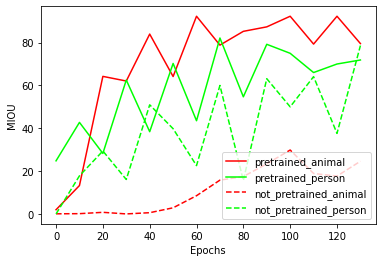

In [ ]:
%matplotlib inline
def parse_val_performance(file_name):
    with open(file_name, 'r') as file:
        data = file.readlines()
    scores = defaultdict(list)
    for class_name in class_mappings.values():
        for line in data:
            if line.startswith(class_name):
                scores[class_name].append(float(line.replace(class_name, '').replace(' ','')))
    return scores
        
fig = plt.figure()
ax = fig.add_subplot(111) 
for file_name, linestyle in [['pretrained.out', 'solid'],['not_pretrained.out', 'dashed'] ]:
    scores = parse_val_performance(file_name)
    for class_idx, (k, v) in enumerate(scores.items()):
        name= f"{file_name.replace('.out','')}_{k}"
        color = [x/255. for x in colors[class_idx % len(colors)]]
        epochs_per_eval = tf_train_proto.evaluation_config.validation_period_during_training
        ax.plot([x * epochs_per_eval for x in range(len(v))], v ,color = color, linestyle = linestyle, label = name)
        
    ax.legend(loc="lower right")            
    ax.set_xlabel("Epochs")
    ax.set_ylabel("MIOU")    
fig.show()
plt.show()

In [ ]:
!ls -lh $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights

## Prune the trained model
* Note that this is just one of the compression techniques that nvidia-offers.
* Quantize aware training is explained in the original notebook. It can plug right in here.


<i>From the original nvidia notebook</i>:
* Usually, you just need to adjust `-pth` (threshold) for accuracy and model size trade off. Higher `pth` gives you smaller model (and thus higher inference speed) but worse accuracy. The threshold to use is dependent on the dataset. A pth value `5.2e-6` is just a start point. If the retrain accuracy is good, you can increase this value to get smaller models. Otherwise, lower this value to get better accuracy.*

* For some internal studies, we have noticed that a pth value of 0.01 is a good starting point for detectnet_v2 models.*

In [ ]:
# Create an output directory if it doesn't exist.
PRUNED_MODEL_FILE_NAME = os.environ['PRUNED_MODEL_FILE_NAME'] = f"{MODEL_NAME}{NUM_LAYERS}_pruned"
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned
!tlt detectnet_v2 prune \
                  -m $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights/$MODEL_FILE_NAME.tlt \
                  -o $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned/$PRUNED_MODEL_FILE_NAME.tlt \
                  -eq union \
                  -pth 0.01 \
                  -k $KEY

In [ ]:
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned

##### Retrain the pruned model
* Model needs to be re-trained to bring back accuracy after pruning
* Specify re-training specification with pretrained weights as pruned model.



In [ ]:
#Configure Retraining params 
tf_train_proto = load_proto(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())
tf_train_proto.model_config.pretrained_model_file = os.path.join(DOCKER_ROOT,EXPERIMENT_DIR, f"experiment_dir_pruned/{PRUNED_MODEL_FILE_NAME}.tlt")
tf_train_proto.training_config.num_epochs = RETRAIN_EPOCHS
tf_train_proto.model_config.load_graph = True # Required for retraining
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, RETRAIN_PROTO), 'w') as file:
    file.write(str(tf_train_proto))

In [ ]:
!cat $LOCAL_ROOT/$SPECS_DIR/$RETRAIN_PROTO

In [ ]:
# Retraining using the pruned model as pretrained weights 
!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$RETRAIN_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain \
                        -k $KEY \
                        -n $PRUNED_MODEL_FILE_NAME \
                        --gpus $NUM_GPUS

In [ ]:
# Listing the newly retrained model.
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain/weights

## Visualize inferences


#### Configure inference params

In [ ]:

tf_infer_proto = load_reference_proto(os.path.join(LOCAL_ROOT, SPECS_DIR, TLT_INFERENCE_PROTO), inference_pb2.Inference())
tf_infer_proto.inferencer_config.ClearField("target_classes")
tf_infer_proto.bbox_handler_config.ClearField("classwise_bbox_handler_config")
#We need to set a few things here...


if len(colors) < len(class_mappings):
    print("Not enough colors to represent classes. Colors will repeat")
    
for idx, value in enumerate(set(class_mappings.values())):
    tf_infer_proto.inferencer_config.target_classes.append(value)

    for k,v in default_postprocessing_params.items():
        setattr(tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].clustering_config, k, v)
        tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].output_map = value
        tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].confidence_model = "aggregate_cov"        
        for c_idx, c in enumerate(['R', 'G', 'B']):
            setattr(tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].bbox_color, c, colors[idx%len(colors)][c_idx])

tf_infer_proto.inferencer_config.image_width = IMAGE_W
tf_infer_proto.inferencer_config.image_height = IMAGE_H

#Pick whichever

NON_PRUNED_WEIGHTS = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR, f"experiment_dir_unpruned/weights/{MODEL_FILE_NAME}.tlt")
PRUNED_WEIGHTS = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR,f"experiment_dir_retrain/weights/{PRUNED_MODEL_FILE_NAME}.tlt")
tf_infer_proto.inferencer_config.tlt_config.model = PRUNED_WEIGHTS

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TLT_INFERENCE_PROTO), 'w') as file:
    file.write(str(tf_infer_proto))

In [ ]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TLT_INFERENCE_PROTO

In [ ]:
!ls detectnet_v2/experiment_dir_unpruned/weights/

In [ ]:
!tlt detectnet_v2 inference -e $DOCKER_ROOT/$SPECS_DIR/$TLT_INFERENCE_PROTO \
                            -o $DOCKER_ROOT/$EXPERIMENT_DIR/tlt_infer_testing \
                            -i $DOCKER_ROOT/$TESTING_DIR/$IMAGE_DIR \
                            -k $KEY

In [ ]:
# Simple grid visualizer
%matplotlib inline

valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_inference_dir(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join(LOCAL_ROOT,EXPERIMENT_DIR ,image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

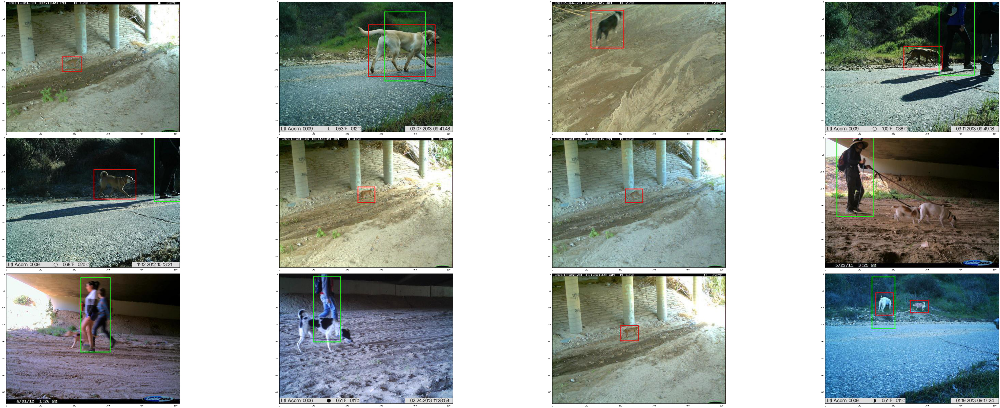

In [ ]:
# Visualizing the first 12 images.
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 
IMAGES = 12
visualize_inference_dir(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## Model Export

#### TLT export

In [ ]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_final
# Removing a pre-existing copy of the etlt if there has been any.

output_file=os.path.join(LOCAL_ROOT, EXPERIMENT_DIR,
                         f"experiment_dir_final/{MODEL_NAME}{NUM_LAYERS}_detector.etlt")
if os.path.exists(output_file):
    os.system("rm {}".format(output_file))
    
!tlt detectnet_v2 export \
                  -m $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain/weights/$PRUNED_MODEL_FILE_NAME.tlt \
                  -o $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.etlt \
                  -k $KEY

In [ ]:
print('Exported model:')
print('------------')
!ls -lh $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_final

#### Generate TensorRT engine 

In [ ]:

!tlt tlt-converter $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.etlt \
                   -k $KEY \
                   -c $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/calibration.bin \
                   -o output_cov/Sigmoid,output_bbox/BiasAdd \
                   -d 3,$IMAGE_H,$IMAGE_W \
                   -i nchw \
                   -m 32 \
                   -t fp32 \
                   -e $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.trt \
                   -b 4 \
                   -w 8737418240


In [ ]:
!ls detectnet_v2/experiment_dir_final/

resnet18_pruned.etlt  resnet18_pruned.trt


### A. Inference using TensorRT engine <a class="anchor" id="head-11-1"></a>

In [ ]:
tf_infer_proto.inferencer_config.ClearField("tlt_config")
TRT_MODEL = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR,f"experiment_dir_final/{PRUNED_MODEL_FILE_NAME}.trt")
tf_infer_proto.inferencer_config.tensorrt_config.trt_engine =TRT_MODEL
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TRT_INFERENCE_PROTO), 'w') as file:
    file.write(str(tf_infer_proto))

In [ ]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TRT_INFERENCE_PROTO
!ls -lrt $LOCAL_ROOT/detectnet_v2/experiment_dir_final/

In [ ]:
!tlt detectnet_v2 inference -e $DOCKER_ROOT/$SPECS_DIR/$TRT_INFERENCE_PROTO \
                            -o $DOCKER_ROOT/$EXPERIMENT_DIR/etlt_infer_testing \
                            -i $DOCKER_ROOT/$TESTING_DIR/$IMAGE_DIR \
                            -k $KEY


In [ ]:
!ls $LOCAL_ROOT/$EXPERIMENT_DIR/etlt_infer_testing

images_annotated  labels


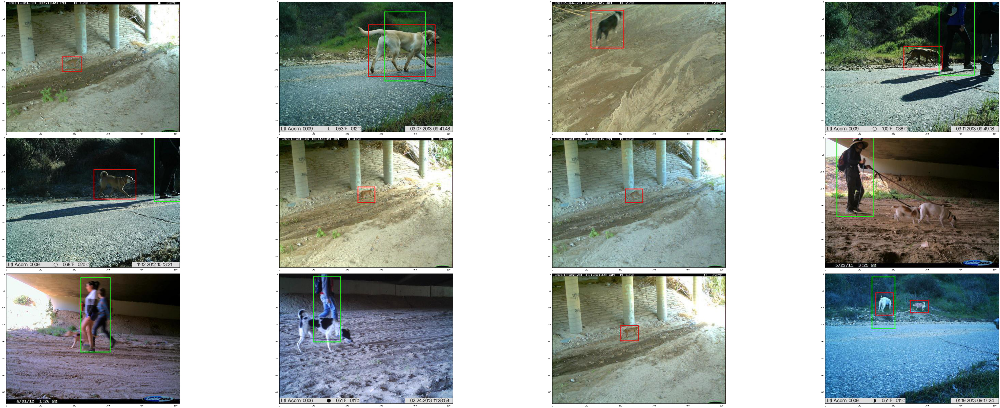

In [ ]:
OUTPUT_PATH = 'etlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.
visualize_inference_dir(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

### Deploy Model to NVIDIA Triton Inference Server

* Once the model has been converted into a trt engine, creating a production grade deployment is as easy as the following

In [ ]:
#Move the file to a directory for deployment

!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/deploy/$PRUNED_MODEL_FILE_NAME/1
!mv $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.trt $LOCAL_ROOT/$EXPERIMENT_DIR/deploy/$PRUNED_MODEL_FILE_NAME/1/

In [ ]:

os.system(
    "nvidia-docker run \
       --gpus=1 \
       --rm \
       --shm-size=1g \
       --ulimit memlock=-1 \
       --ulimit stack=67108864 \
       -p8000:8000 \
       -p8001:8001 \
       -p8002:8002 \
       -v$LOCAL_ROOT/$EXPERIMENT_DIR/deploy:/models nvcr.io/nvidia/tritonserver:20.11-py3 \
       tritonserver \
       --model-repository=/models \
       --strict-model-config=false &"
)

0

#### Client wrapper

In [ ]:
#Thanks - https://medium.com/nvidia-ai/how-to-deploy-almost-any-hugging-face-model-on-nvidia-triton-inference-server-with-an-8ee7ec0e6fc4"

def print_model_meta(model_name=PRUNED_MODEL_FILE_NAME, url='0.0.0.0:8000', model_version='1'):
    model_metadata = triton_client.get_model_metadata(model_name=model_name, model_version=model_version)
    model_config = triton_client.get_model_config(model_name=model_name, model_version=model_version),
    print(model_config)
    print(model_metadata)
    
def preprocess(img):
    if len(img.shape) == 3:
        img = np.expand_dims(img, axis = 0)
    img = img / 255. 
    return img.astype(np.float32).transpose((0,3,1,2))
    

def run_inference(img, model_name=PRUNED_MODEL_FILE_NAME, url='0.0.0.0:8000', model_version='1'):
    img = preprocess(img)
    triton_client = tritonhttpclient.InferenceServerClient(url=url, verbose=False)
    input0 = tritonhttpclient.InferInput("input_1", (1, 3,IMAGE_H,IMAGE_W), 'FP32')
    input0.set_data_from_numpy(img, binary_data=False)
    output0 = tritonhttpclient.InferRequestedOutput("output_bbox/BiasAdd",  binary_data=False)
    output1 = tritonhttpclient.InferRequestedOutput("output_cov/Sigmoid",  binary_data=False)
    response = triton_client.infer(model_name,model_version=model_version, inputs=[input0], outputs=[output0, output1])
    covs = response.as_numpy("output_cov/Sigmoid")
    boxes = response.as_numpy("output_bbox/BiasAdd") 
    return covs, boxes


#### Postprocessing

In [ ]:
#Thanks - carlos.alvarez https://forums.developer.nvidia.com/t/run-peoplenet-with-tensorrt/128000/21

def applyBoxNorm(o1, o2, o3, o4, x, y, grid_centers_w, grid_centers_h, box_norm):
    o1 = (o1 - grid_centers_w[x]) * -box_norm
    o2 = (o2 - grid_centers_h[y]) * -box_norm
    o3 = (o3 + grid_centers_w[x]) * box_norm
    o4 = (o4 + grid_centers_h[y]) * box_norm
    return o1, o2, o3, o4


def postprocess(outputs, min_confidence, analysis_classes, model_h, model_w,stride = 16, box_norm = 35, wh_format=True):
    grid_h = int(model_h / stride)
    grid_w = int(model_w / stride)
    grid_size = grid_h * grid_w

    grid_centers_w = []
    grid_centers_h = []

    for i in range(grid_h):
        value = (i * stride + 0.5) / box_norm
        grid_centers_h.append(value)

    for i in range(grid_w):
        value = (i * stride + 0.5) / box_norm
        grid_centers_w.append(value)
        
        
    bbs = []
    class_ids = []
    scores = []
    for c in analysis_classes:


        x1_idx = c * 4 * grid_size
        y1_idx = x1_idx + grid_size
        x2_idx = y1_idx + grid_size
        y2_idx = x2_idx + grid_size

        boxes = outputs[0]
        for h in range(grid_h):
            for w in range(grid_w):
                i = w + h * grid_w
                score = outputs[1][c * grid_size + i]
                if score >= min_confidence:
                    o1 = boxes[x1_idx + w + h * grid_w]
                    o2 = boxes[y1_idx + w + h * grid_w]
                    o3 = boxes[x2_idx + w + h * grid_w]
                    o4 = boxes[y2_idx + w + h * grid_w]

                    o1, o2, o3, o4 = applyBoxNorm(o1, o2, o3, o4, w, h, grid_centers_w, grid_centers_h, box_norm)

                    xmin = int(o1)
                    ymin = int(o2)
                    xmax = int(o3)
                    ymax = int(o4)
                    if wh_format:
                        bbs.append([xmin, ymin, xmax - xmin, ymax - ymin])
                    else:
                        bbs.append([xmin, ymin, xmax, ymax])
                    class_ids.append(c)
                    scores.append(float(score))
    return bbs, class_ids, scores


def predict(image, model_h, model_w, threshold = 0.1):
    image = cv2.resize(image, (model_w, model_h))
    keepCount_out, detection_out  = run_inference(image)
    num_classes = detection_out.shape[0]
    detection_out = detection_out.reshape(-1)
    keepCount_out = keepCount_out.reshape(-1)
    bboxes, class_ids, scores = postprocess(
        [detection_out, keepCount_out], 
        threshold, 
        list(range(num_classes)), 
        model_h, model_w
    )
    indices = cv2.dnn.NMSBoxes(bboxes, scores, threshold, 0.5)
    inferences = []
    for idx in indices:
        inferences.append({
            'bbox' : bboxes[int(idx)],
            'class_id' : class_ids[int(idx)]
        })
    return inferences

def visualize_inference(image, inferences, model_h, model_w):
    image = cv2.resize(image.copy(), (model_w, model_h))
    for inference in inferences:
        xmin, ymin, w, h = inference['bbox']
        class_id = inference['class_id']
        color = [255, 0, 0] if class_id else [0, 0, 255]
        cv2.rectangle(image, (xmin, ymin), (xmin + w, ymin + h), color, 2)
    plt.imshow(image)
    plt.show()

### Make a request to the deployed model!
<b> Make sure you wait for the triton server to start!</b>
* It will be ready when you see Start <service> at <ip>:port>

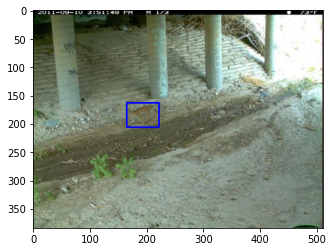

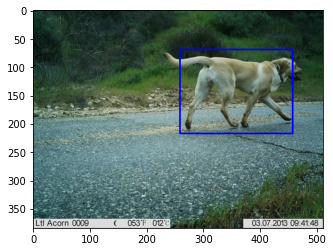

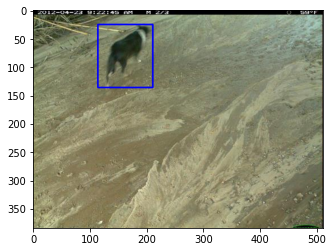

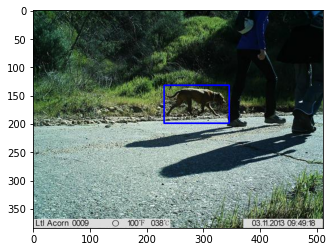

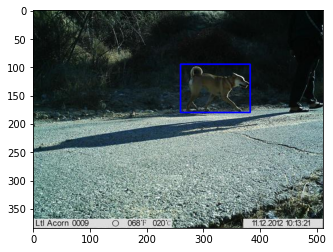

In [ ]:
fs = [os.path.join(TEST_IMAGE_DIR, f) for f in os.listdir(TEST_IMAGE_DIR)]
for idx in range(5):
    image = cv2.imread(fs[idx])[..., ::-1]
    #Call the remote server
    inferences = predict(image, IMAGE_H, IMAGE_W)
    visualize_inference(image, inferences, IMAGE_H, IMAGE_W)